Assignment_03
Name: Yash Wadhwa NUID: 002778382

Study the decision tree algorithm, focusing on both entropy based information gain and Gini index for splitting. Build decision trees and random forests for the loan datasets.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.metrics import plot_confusion_matrix
%matplotlib inline

In [2]:
df = pd.read_excel("/Users/wadhwa/Desktop/dsem/Assignment-3/loan.xlsx")
df.head()

,Sex,Age,Time_at_address,Res_status,Telephone,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,given,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,not_given,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,given,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,not_given,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,given,driver,governmen,0,0,f,given,228,0,reject


In [3]:
df.dtypes

Sex                 object
Age                float64
Time_at_address    float64
Res_status          object
Telephone           object
Occupation          object
Job_status          object
Time_employed        int64
Time_bank            int64
Liab_ref            object
Acc_ref             object
Home_Expn            int64
Balance              int64
Decision            object
dtype: object

In [4]:
X = df.drop('Decision', axis=1).copy()
y = df['Decision'].copy()
X

,Sex,Age,Time_at_address,Res_status,Telephone,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance
0,M,50.750000,0.585,owner,given,unemploye,unemploye,0,0,f,given,145,0
1,M,19.670000,10.000,rent,not_given,labourer,governmen,0,0,t,given,140,0
2,F,52.830002,15.000,owner,given,creative_,private_s,5,14,f,given,0,2200
3,M,22.670000,2.540,rent,not_given,creative_,governmen,2,0,f,given,0,0
4,M,29.250000,13.000,owner,given,driver,governmen,0,0,f,given,228,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,M,34.169998,2.750,owner,given,guard_etc,self_empl,2,0,t,given,232,200
425,F,22.250000,1.250,rent,not_given,unemploye,unemploye,3,0,f,given,280,0
426,M,23.330000,1.500,owner,given,creative_,governmen,1,0,f,given,422,200
427,M,21.000000,4.790,rent,not_given,productio,private_s,2,1,t,given,80,300


In [5]:
X_encoded = pd.get_dummies(X, columns=['Sex','Res_status','Telephone','Occupation','Job_status','Liab_ref','Acc_ref'])
X_encoded

,Age,Time_at_address,Time_employed,Time_bank,Home_Expn,Balance,Sex_F,Sex_M,Res_status_owner,Res_status_rent,...,Job_status_military,Job_status_private_s,Job_status_retired,Job_status_self_empl,Job_status_student,Job_status_unemploye,Liab_ref_f,Liab_ref_t,Acc_ref_given,Acc_ref_oth_inst_
0,50.750000,0.585,0,0,145,0,0,1,1,0,...,0,0,0,0,0,1,1,0,1,0
1,19.670000,10.000,0,0,140,0,0,1,0,1,...,0,0,0,0,0,0,0,1,1,0
2,52.830002,15.000,5,14,0,2200,1,0,1,0,...,0,1,0,0,0,0,1,0,1,0
3,22.670000,2.540,2,0,0,0,0,1,0,1,...,0,0,0,0,0,0,1,0,1,0
4,29.250000,13.000,0,0,228,0,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,34.169998,2.750,2,0,232,200,0,1,1,0,...,0,0,0,1,0,0,0,1,1,0
425,22.250000,1.250,3,0,280,0,1,0,0,1,...,0,0,0,0,0,1,1,0,1,0
426,23.330000,1.500,1,0,422,200,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
427,21.000000,4.790,2,1,80,300,0,1,0,1,...,0,1,0,0,0,0,0,1,1,0


Building Decision Tree: 

1. Using Gini Index 

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, random_state=0)

cls_dtree = DecisionTreeClassifier()
cls_dtree = cls_dtree.fit(X_train, y_train)

[Text(0.737360853432282, 0.96875, 'Time_bank <= 2.5\ngini = 0.494\nsamples = 321\nvalue = [143, 178]\nclass = Decision: Accept'),
 Text(0.5415120593692022, 0.90625, 'Time_employed <= 3.5\ngini = 0.417\nsamples = 236\nvalue = [70, 166]\nclass = Decision: Accept'),
 Text(0.33534322820037105, 0.84375, 'Balance <= 5676.0\ngini = 0.376\nsamples = 211\nvalue = [53, 158]\nclass = Decision: Accept'),
 Text(0.3205009276437848, 0.78125, 'Home_Expn <= 71.5\ngini = 0.353\nsamples = 205\nvalue = [47, 158]\nclass = Decision: Accept'),
 Text(0.14842300556586271, 0.71875, 'Home_Expn <= 44.5\ngini = 0.485\nsamples = 41\nvalue = [17, 24]\nclass = Decision: Accept'),
 Text(0.13358070500927643, 0.65625, 'Time_employed <= 1.5\ngini = 0.456\nsamples = 37\nvalue = [13, 24]\nclass = Decision: Accept'),
 Text(0.1038961038961039, 0.59375, 'Job_status_governmen <= 0.5\ngini = 0.391\nsamples = 30\nvalue = [8, 22]\nclass = Decision: Accept'),
 Text(0.08905380333951762, 0.53125, 'Job_status_student <= 0.5\ngini = 0

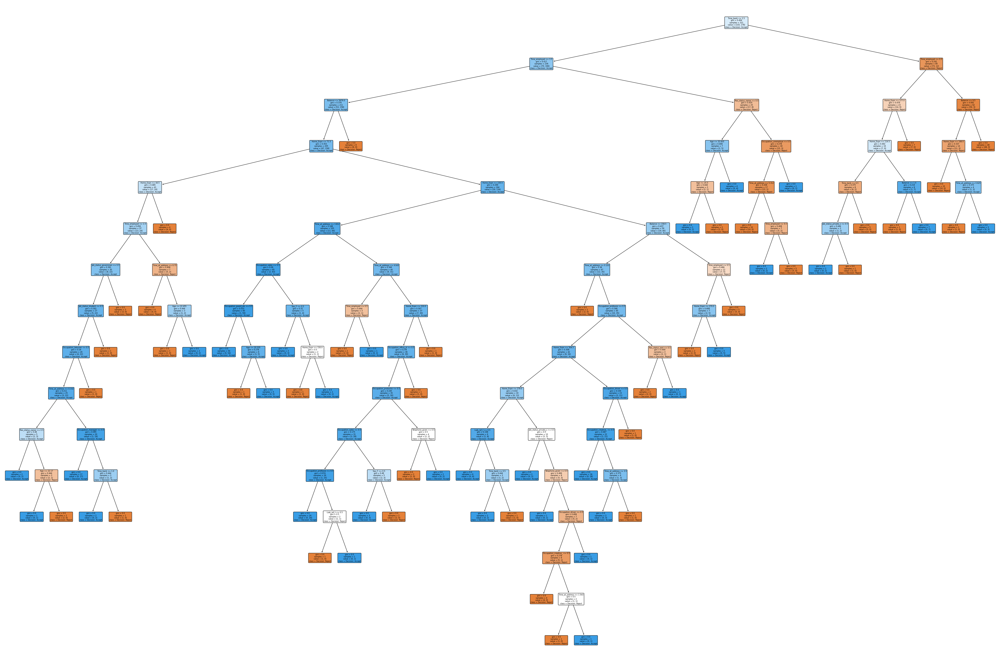

In [8]:
plt.figure(figsize = (60, 40))
plot_tree(cls_dtree, filled=True, rounded=True, class_names=["Decision: Reject","Decision: Accept"], feature_names=X_encoded.columns)

In [9]:
y_pred = cls_dtree.predict(X_test)

In [10]:
print(classification_report(y_test, y_pred))
accuracy_score(y_test, y_pred)

              precision    recall  f1-score   support

      accept       0.63      0.65      0.64        49
      reject       0.70      0.68      0.69        59

    accuracy                           0.67       108
   macro avg       0.66      0.67      0.66       108
weighted avg       0.67      0.67      0.67       108



0.6666666666666666

2. Using Entropy Based Information Gain

In [11]:
cls_dtree_ent = DecisionTreeClassifier(criterion='entropy')
cls_dtree_ent = cls_dtree_ent.fit(X_train, y_train)

[Text(0.7077294685990339, 0.9722222222222222, 'Time_bank <= 2.5\nentropy = 0.991\nsamples = 321\nvalue = [143, 178]\nclass = Decision: Accept'),
 Text(0.5458937198067633, 0.9166666666666666, 'Time_employed <= 3.5\nentropy = 0.877\nsamples = 236\nvalue = [70, 166]\nclass = Decision: Accept'),
 Text(0.4782608695652174, 0.8611111111111112, 'Balance <= 5676.0\nentropy = 0.813\nsamples = 211\nvalue = [53, 158]\nclass = Decision: Accept'),
 Text(0.45893719806763283, 0.8055555555555556, 'Age <= 18.46\nentropy = 0.777\nsamples = 205\nvalue = [47, 158]\nclass = Decision: Accept'),
 Text(0.4396135265700483, 0.75, 'entropy = 0.0\nsamples = 18\nvalue = [0, 18]\nclass = Decision: Accept'),
 Text(0.4782608695652174, 0.75, 'Job_status_unemploye <= 0.5\nentropy = 0.813\nsamples = 187\nvalue = [47, 140]\nclass = Decision: Accept'),
 Text(0.45893719806763283, 0.6944444444444444, 'Time_bank <= 0.5\nentropy = 0.848\nsamples = 171\nvalue = [47, 124]\nclass = Decision: Accept'),
 Text(0.33816425120772947, 0

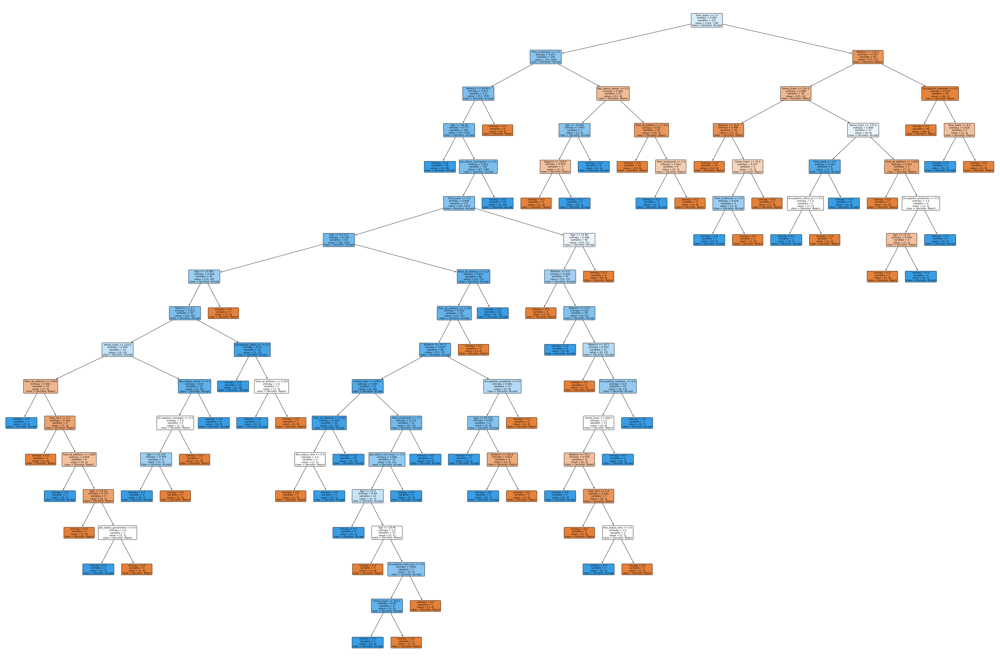

In [12]:
plt.figure(figsize = (60, 40))
plot_tree(cls_dtree_ent, filled=True, rounded=True, class_names=["Decision: Reject","Decision: Accept"], feature_names=X_encoded.columns)

In [13]:
y_pred = cls_dtree_ent.predict(X_test)

In [14]:
print(classification_report(y_test, y_pred))
accuracy_score(y_test, y_pred)

              precision    recall  f1-score   support

      accept       0.72      0.63      0.67        49
      reject       0.72      0.80      0.76        59

    accuracy                           0.72       108
   macro avg       0.72      0.71      0.72       108
weighted avg       0.72      0.72      0.72       108



0.7222222222222222

Building Random Forest:

1. Using Entropy based Infromation Gain

In [32]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as mno
from sklearn import tree
from sklearn.tree import plot_tree
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.ensemble import RandomForestClassifier

In [33]:
df_loan = pd.read_excel("/Users/wadhwa/Desktop/dsem/Assignment-3/loan.xlsx")
df_loan.head()

,Sex,Age,Time_at_address,Res_status,Telephone,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,given,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,not_given,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,given,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,not_given,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,given,driver,governmen,0,0,f,given,228,0,reject


In [34]:
cols = ['Sex','Age','Time_at_address','Res_status','Telephone','Occupation','Job_status','Time_employed','Time_bank','Liab_ref','Acc_ref','Home_Expn','Balance','Decision']

In [35]:
df_loan.head()

,Sex,Age,Time_at_address,Res_status,Telephone,Occupation,Job_status,Time_employed,Time_bank,Liab_ref,Acc_ref,Home_Expn,Balance,Decision
0,M,50.750000,0.585,owner,given,unemploye,unemploye,0,0,f,given,145,0,reject
1,M,19.670000,10.000,rent,not_given,labourer,governmen,0,0,t,given,140,0,reject
2,F,52.830002,15.000,owner,given,creative_,private_s,5,14,f,given,0,2200,accept
3,M,22.670000,2.540,rent,not_given,creative_,governmen,2,0,f,given,0,0,accept
4,M,29.250000,13.000,owner,given,driver,governmen,0,0,f,given,228,0,reject


In [36]:
df_loan.dtypes

Sex                 object
Age                float64
Time_at_address    float64
Res_status          object
Telephone           object
Occupation          object
Job_status          object
Time_employed        int64
Time_bank            int64
Liab_ref            object
Acc_ref             object
Home_Expn            int64
Balance              int64
Decision            object
dtype: object

In [37]:
X = df_loan.drop('Decision', axis=1).copy()
y = df_loan['Decision'].copy()

In [38]:
X_encoded = pd.get_dummies(X, columns=['Sex','Res_status','Telephone','Occupation','Job_status','Liab_ref','Acc_ref'])
X_encoded

,Age,Time_at_address,Time_employed,Time_bank,Home_Expn,Balance,Sex_F,Sex_M,Res_status_owner,Res_status_rent,...,Job_status_military,Job_status_private_s,Job_status_retired,Job_status_self_empl,Job_status_student,Job_status_unemploye,Liab_ref_f,Liab_ref_t,Acc_ref_given,Acc_ref_oth_inst_
0,50.750000,0.585,0,0,145,0,0,1,1,0,...,0,0,0,0,0,1,1,0,1,0
1,19.670000,10.000,0,0,140,0,0,1,0,1,...,0,0,0,0,0,0,0,1,1,0
2,52.830002,15.000,5,14,0,2200,1,0,1,0,...,0,1,0,0,0,0,1,0,1,0
3,22.670000,2.540,2,0,0,0,0,1,0,1,...,0,0,0,0,0,0,1,0,1,0
4,29.250000,13.000,0,0,228,0,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
424,34.169998,2.750,2,0,232,200,0,1,1,0,...,0,0,0,1,0,0,0,1,1,0
425,22.250000,1.250,3,0,280,0,1,0,0,1,...,0,0,0,0,0,1,1,0,1,0
426,23.330000,1.500,1,0,422,200,0,1,1,0,...,0,0,0,0,0,0,1,0,1,0
427,21.000000,4.790,2,1,80,300,0,1,0,1,...,0,1,0,0,0,0,0,1,1,0


In [39]:
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2)

In [40]:
cls_rf = RandomForestClassifier(n_estimators=100, criterion='entropy')
cls_rf.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy')

In [41]:
cols = df_loan.columns
xn = X_encoded.columns
yn = cols[-1]
fig, axes = plt.subplots(nrows=1, ncols=4,figsize=(10,5), dpi=3000)
for i in range(0, 4):
    tree.plot_tree(cls_rf.estimators_[i],
                  feature_names = xn,
                  class_names = yn,
                  filled = True,
                  ax = axes[i]);
    axes[i].set_title('Estimator ' + str(i), fontsize = 11)

In [42]:
y_pred = cls_rf.predict(X_test)

In [43]:
print(classification_report(y_test, y_pred))
accuracy_score(y_test, y_pred)

              precision    recall  f1-score   support

      accept       0.74      0.76      0.75        33
      reject       0.85      0.83      0.84        53

    accuracy                           0.80        86
   macro avg       0.79      0.79      0.79        86
weighted avg       0.80      0.80      0.80        86



0.8023255813953488

2. Using Gini Index

In [44]:
cls_rf_gini = RandomForestClassifier(n_estimators=100)
cls_rf_gini.fit(X_train, y_train)

RandomForestClassifier()

In [45]:
cols = df_loan.columns
xn = X_encoded.columns
yn = cols[-1]
fig, axes = plt.subplots(nrows=1, ncols=4,figsize=(10,5), dpi=3000)
for i in range(0, 4):
    tree.plot_tree(cls_rf_gini.estimators_[i],
                  feature_names = xn,
                  class_names = yn,
                  filled = True,
                  ax = axes[i]);
    axes[i].set_title('Estimator ' + str(i), fontsize = 11)

In [46]:
print(classification_report(y_test, y_pred))
accuracy_score(y_test, y_pred)

              precision    recall  f1-score   support

      accept       0.74      0.76      0.75        33
      reject       0.85      0.83      0.84        53

    accuracy                           0.80        86
   macro avg       0.79      0.79      0.79        86
weighted avg       0.80      0.80      0.80        86



0.8023255813953488